# Detectron2 Training

### This note book is built on top of [Roboflow's Tutorial](https://colab.research.google.com/drive/1-TNOcPm3Jr3fOJG8rnGT9gh60mHUsvaW#scrollTo=wXisIbT1Zqou)

# Install Detectron2 Dependencies

In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 22 kB/s 
     |████████████████████████████████| 6.6 MB 32.5 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.5.0+cu101 which is incompatible.
     |████████████████████████████████| 274 kB 8.0 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44091 sha256=6504ed944d39372bba9a2bf34e858b

In [ ]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 3.2 MB/s 
     |████████████████████████████████| 49 kB 3.3 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210727-py3-none-any.whl size=60614 sha256=97644bea344b4b0e03705c79d905f9f70a4ce95d2a85a21caae4b3f92593a2b0
  Stored in directory: /root/.cache/pip/wheels/1a/bc/3c/f433f08e3bed2c9ee317baeacdc691da8433a553e0dcc77f78
Successfully built fvcore


In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [ ]:
!curl -L "[ROBOFLOW DOWNLOAD LINK]" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1426      0 --:--:-- --:--:-- --:--:--  1426
100 41.7M  100 41.7M    0     0  28.5M      0  0:00:01  0:00:01 --:--:--  235M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/OC_paper_10page_19_GDOg08g_jpg.rf.e354ae0ba8ae7a0a5d2f967ef2cc9e1e.jpg  
 extracting: test/OC_paper_10page_22_3PkZj5o_jpg.rf.64b6d376b06de83cc850cdb01d9ee9c6.jpg  
 extracting: test/OC_paper_10page_52_1vwFCFL_jpg.rf.465125e91f26498a9570dad3a57dabfc.jpg  
 extracting: test/OC_paper_10page_57_sqn1Vg0_jpg.rf.de26c677afdf4d72edeabf8f7f8c52cd.jpg  
 extracting: test/OC_paper_10page_60_lry8YBM_jpg.rf.e9500b074524ca78911fb575dcc827d4.jpg  
 extracting: test/OC_paper_10page_82_HGZYakz_jpg.rf.804b7e8e3c73c3581c42d52fda630e81.jpg  
 extracting: test/OC_paper_10page_83_bDSItvF_jpg.rf.c58bd1

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [07/28 07:42:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/28 07:42:45 d2.data.datasets.coco]: Loaded 617 images in COCO format from /content/train/_annotations.coco.json


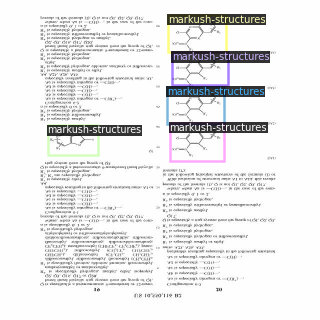

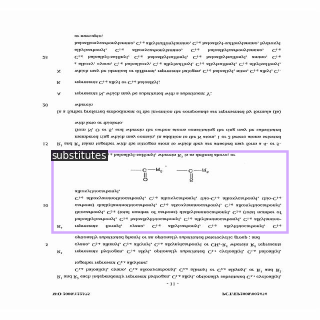

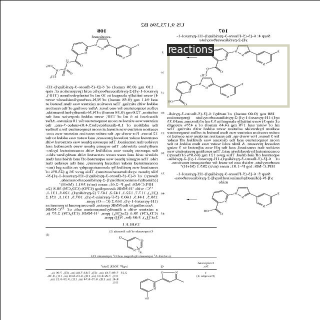

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [ ]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 6 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[07/28 07:42:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:04, 34.0MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (7, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (7,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (24, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (24,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_p

[07/28 07:43:02 d2.engine.train_loop]: Starting training from iteration 0
[07/28 07:43:10 d2.utils.events]:  eta: 0:31:47  iter: 19  total_loss: 2.754  loss_cls: 2.143  loss_box_reg: 0.352  loss_rpn_cls: 0.241  loss_rpn_loc: 0.030  time: 0.3838  data_time: 0.0380  lr: 0.000020  max_mem: 3160M
[07/28 07:43:17 d2.utils.events]:  eta: 0:31:31  iter: 39  total_loss: 2.187  loss_cls: 1.438  loss_box_reg: 0.430  loss_rpn_cls: 0.164  loss_rpn_loc: 0.026  time: 0.3795  data_time: 0.0162  lr: 0.000040  max_mem: 3160M
[07/28 07:43:25 d2.utils.events]:  eta: 0:31:20  iter: 59  total_loss: 1.687  loss_cls: 0.865  loss_box_reg: 0.638  loss_rpn_cls: 0.068  loss_rpn_loc: 0.017  time: 0.3797  data_time: 0.0204  lr: 0.000060  max_mem: 3160M
[07/28 07:43:33 d2.utils.events]:  eta: 0:31:21  iter: 79  total_loss: 1.683  loss_cls: 0.802  loss_box_reg: 0.824  loss_rpn_cls: 0.043  loss_rpn_loc: 0.023  time: 0.3813  data_time: 0.0209  lr: 0.000080  max_mem: 3160M
[07/28 07:43:41 d2.utils.events]:  eta: 0:31:1

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 206), started 0:33:16 ago. (Use '!kill 206' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [07/28 08:15:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[07/28 08:15:30 d2.data.datasets.coco]: Loaded 33 images in COCO format from /content/test/_annotations.coco.json
[07/28 08:15:30 d2.data.build]: Distribution of instances among all 6 categories:
|  category  | #instances   |   category    | #instances   |   category    | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
|   cells    | 0            | intermediates | 8            | markush-str.. | 8            |
| reactions  | 4            | relevant-st.. | 69           |  substitutes  | 9            |
|            |              |               |              |               |              |
|   total    | 98           |               |              |               |              |
[07/28 08:15:30 d2.data.common]: Serializing 33 elements to byte tensors and concatenating them all ...
[07/28 08:

OrderedDict([('bbox',
              {'AP': 21.34190654597611,
               'AP-cells': nan,
               'AP-intermediates': 6.263091562252772,
               'AP-markush-structures': 19.110808293372894,
               'AP-reactions': 24.846684668466846,
               'AP-relevant-structures': 47.27084927714218,
               'AP-substitutes': 9.218098928645862,
               'AP50': 45.87144609451185,
               'AP75': 18.12570634356133,
               'APl': 17.696285291297215,
               'APm': 34.88841741316989,
               'APs': nan})])

# Inference with Detectron2 Saved Weights



In [ ]:
%ls ./output/

coco_instances_results.json                       metrics.json
events.out.tfevents.1627458177.007c10bf793c.61.0  model_0004999.pth
instances_predictions.pth                         model_final.pth
last_checkpoint


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

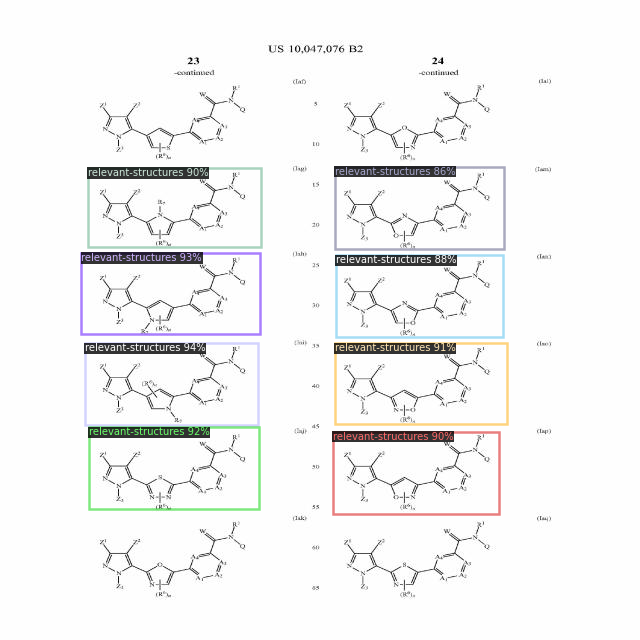

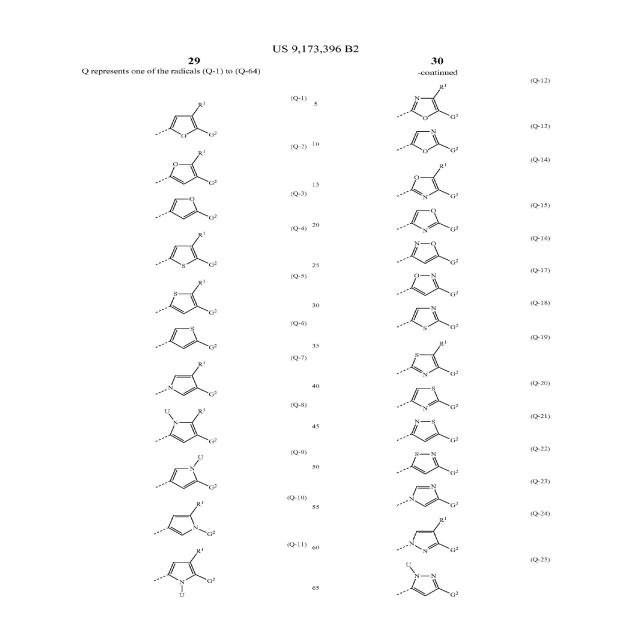

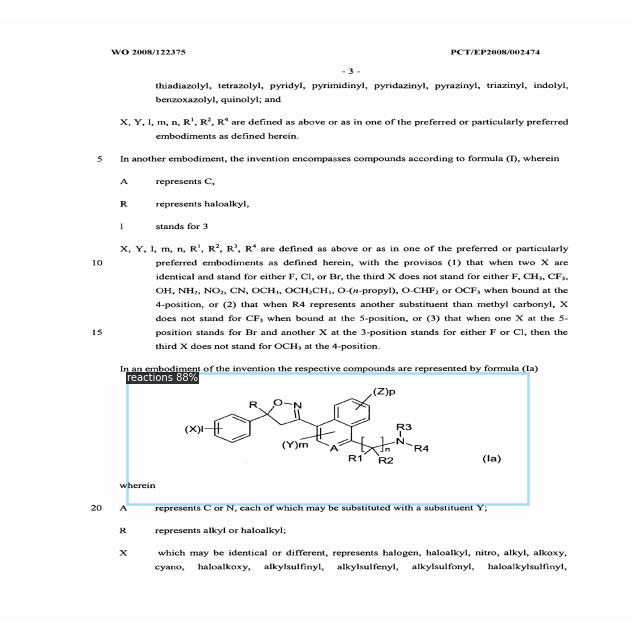

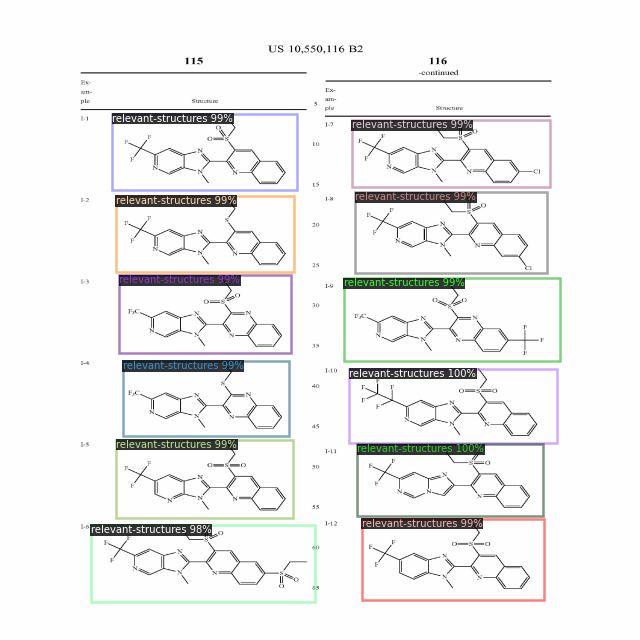

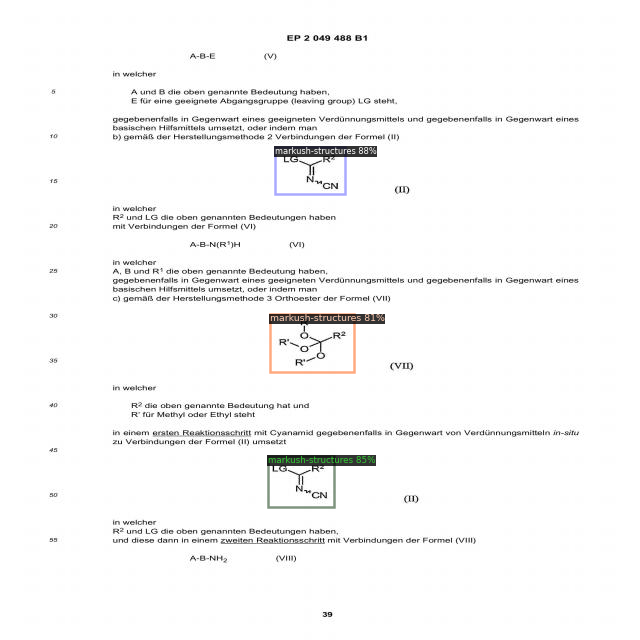

...

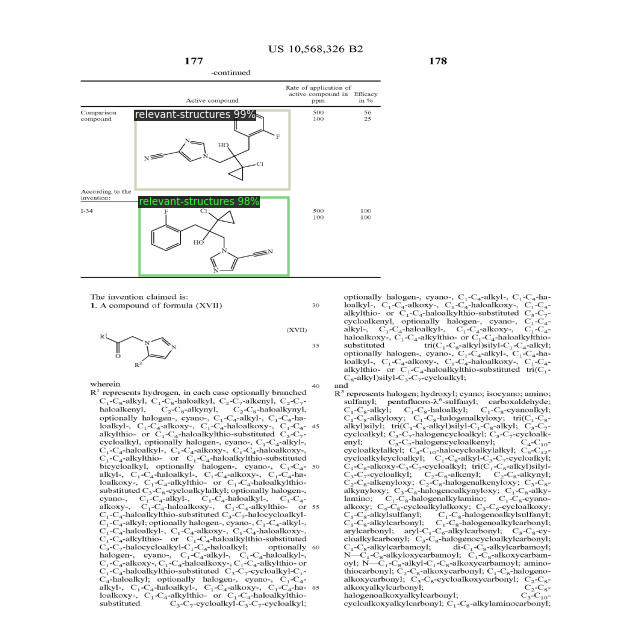

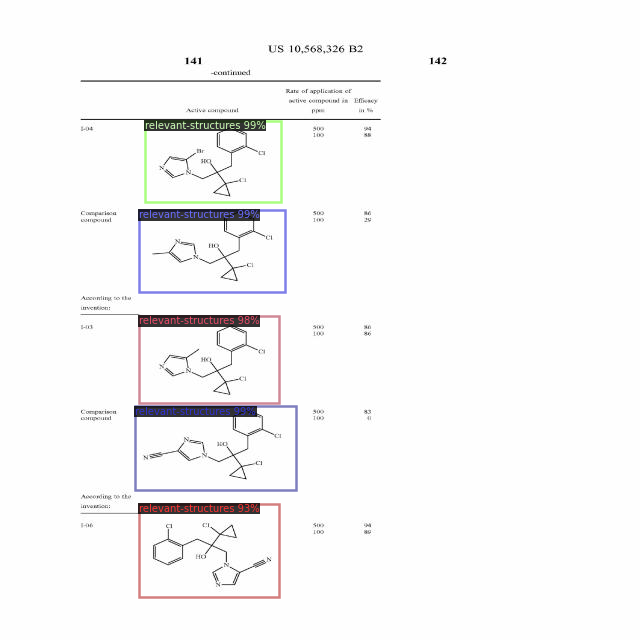

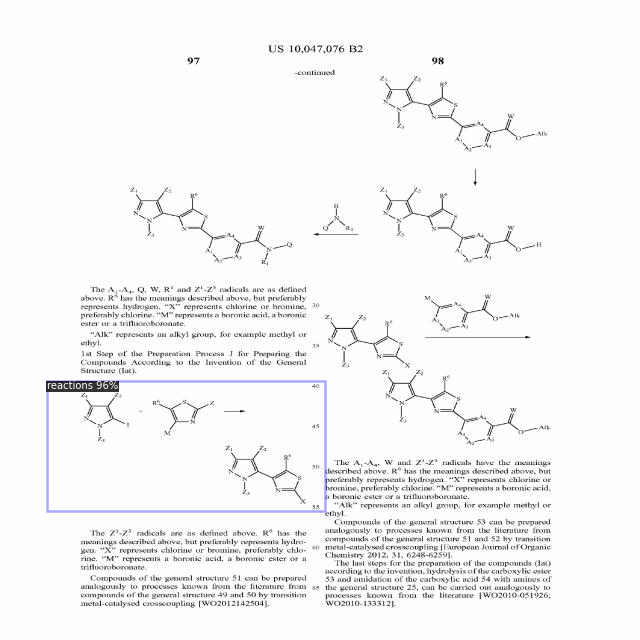

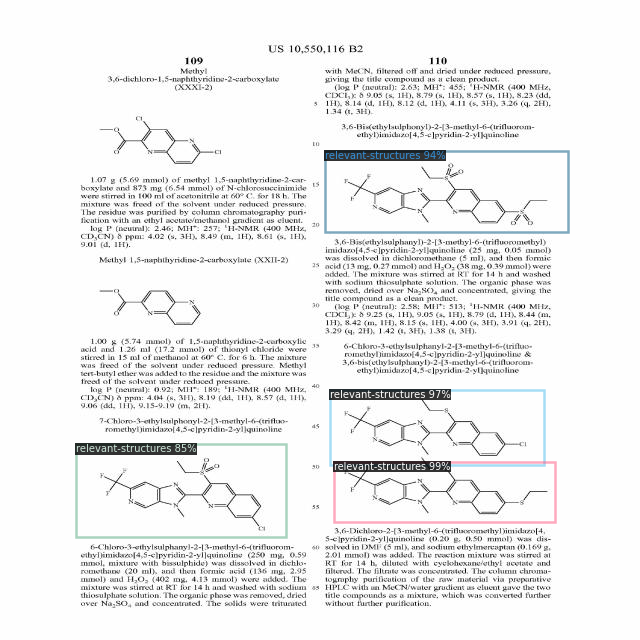

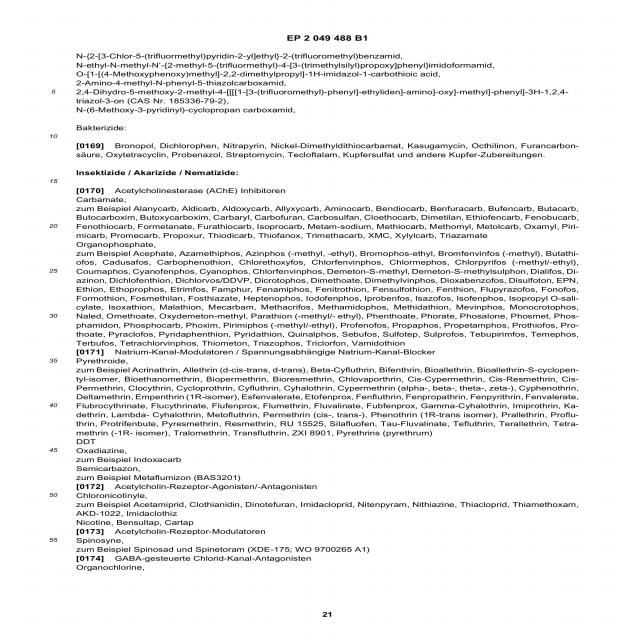

CPU times: user 7.58 s, sys: 210 ms, total: 7.79 s
Wall time: 7.73 s


In [ ]:
%%time
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=1
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


## Getting Custom Configuration file (IMPORTANT)



In [ ]:
f = open('config.yaml', 'w')
f.write(cfg.dump())
f.close()

### Saving model to drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!sudo mv /content/output/model_final.pth /content/drive/MyDrive/structure_extraction/